# Import

In [1]:
import os

os.environ["KMP_DUPLICATE_LIB_OK"] = "True"

from nes_py.wrappers import JoypadSpace
import torch
import numpy as np
import gym
import gym_super_mario_bros
from gym.wrappers import (
    FrameStack,
    GrayScaleObservation,
    ResizeObservation,
    TransformObservation,
    Monitor,
)

# Import own Functions
from src.helper_functions.create_Plot import plot_results, create_plots
from src.helper_functions.create_Agent import MarioAgentEpsilonGreedy

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set Hyperparameters

In [2]:
action_space = [
    ["NOOP"],
    ["A"],
    ["B"],
    ["right"],
    ["left"],
    ["right", "A"],
    ["right", "B"],
    ["right", "A", "B"],
]
buffer_size = 25000
batch_size = 64
learning_rate = 0.00009
stacking_number = 10
online_update_every = 1
exp_before_target_sync = 5000
epsilon_start = 1.0
epsilon_min = 0.01
epsilon_decay = 0.001
gamma = 0.99
num_episodes = 1000
plot_every = 25
save_every = 50

# Set all Paths

In [3]:
# change this version-number to create new folders
train_version = "v4"

trainfolder = "training_" + train_version
vid_folder = os.path.join("res", trainfolder, "all_videos")

model_folder = os.path.join("models")
if not os.path.exists(model_folder):
    os.makedirs(model_folder)

checkpoint_folder = os.path.join(model_folder, trainfolder, "checkpoints")
if not os.path.exists(checkpoint_folder):
    os.makedirs(checkpoint_folder)

plot_folder = os.path.join("res", trainfolder, "plots")
if not os.path.exists(plot_folder):
    os.makedirs(plot_folder)

starting_point = os.path.join(model_folder, "training_v2", "final_model_v2.pth")

# Initialize Environment and other variables

In [4]:
exp_before_training = batch_size + 5

env = gym_super_mario_bros.make("SuperMarioBros-1-1-v0")
env = JoypadSpace(env, action_space)
env = Monitor(env, vid_folder, video_callable=lambda episode_id: True, force=True)
env = GrayScaleObservation(env, keep_dim=False)
env = ResizeObservation(env, shape=84)
env = TransformObservation(env, lambda obs: np.squeeze(obs, axis=-1))
env = TransformObservation(env, f=lambda x: x / 255.0)
env = FrameStack(env, num_stack=stacking_number)

state = env.reset()
state_shape = state.shape


mario = MarioAgentEpsilonGreedy(
    num_actions=len(action_space),
    state_shape=state_shape,
    checkpoint_folder=checkpoint_folder,
    model_folder=model_folder,
    wantcuda=True,
    starting_point=starting_point,
    learning_rate=learning_rate,
    epsilon_start=epsilon_start,
    epsilon_min=epsilon_min,
    epsilon_decay=epsilon_decay,
    batch_size=batch_size,
    gamma=gamma,
    buffer_size=buffer_size,
    exp_before_training=exp_before_training,
    online_update_every=online_update_every,
    exp_before_target_sync=exp_before_target_sync,
    save_every=save_every,
)

# Reset Epsilon because of starting point
mario.epsilon = 0.5

reward_list = []
steps_list = []
q_list = []
loss_list = []
epsilon_list = []

Model loaded from models\training_v2\final_model_v2.pth with epsilon 0.01


# Start the training

c:\Users\nicho\OneDrive\Dokumente\A - DHBW\6. Semester\AML\Abgaben\Coding\Reinforcement-Learning\src\helper_functions\create_Agent.py:104: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ..\torch\csrc\utils\tensor_new.cpp:277.)
  state = torch.tensor(state, dtype=torch.float32, device=self.device)
c:\Users\nicho\OneDrive\Dokumente\A - DHBW\6. Semester\AML\Abgaben\Coding\Reinforcement-Learning\venv\Lib\site-packages\gym_super_mario_bros\smb_env.py:148: RuntimeWarning: overflow encountered in scalar subtract
  return (self.ram[0x86] - self.ram[0x071c]) % 256


Episode 1 abgeschlossen mit 130 Schritten, Gesamtbelohnung: 250.0, Epsilon: 0.5


Episode 2 abgeschlossen mit 8019 Schritten, Gesamtbelohnung: 266.0, Epsilon: 0.499


Episode 3 abgeschlossen mit 8019 Schritten, Gesamtbelohnung: 139.0, Epsilon: 0.498


Episode 4 abgeschlossen mit 8019 Schritten, Gesamtbelohnung: 267.0, Epsilon: 0.497


Episode 5 abgeschlossen mit 126 Schritten, Gesamtbelohnung: 250.0, Epsilon: 0.496


Episode 6 abgeschlossen mit 3432 Schritten, Gesamtbelohnung: 496.0, Epsilon: 0.495


Episode 7 abgeschlossen mit 8019 Schritten, Gesamtbelohnung: 267.0, Epsilon: 0.494


Episode 8 abgeschlossen mit 192 Schritten, Gesamtbelohnung: 234.0, Epsilon: 0.493


Episode 9 abgeschlossen mit 8019 Schritten, Gesamtbelohnung: 267.0, Epsilon: 0.492


Episode 10 abgeschlossen mit 1408 Schritten, Gesamtbelohnung: 597.0, Epsilon: 0.491


Episode 11 abgeschlossen mit 8019 Schritten, Gesamtbelohnung: 266.0, Epsilon: 0.49


Episode 12 abgeschlossen mit 184 Schritten, Gesamtbelohnung: 226.0, E

c:\Users\nicho\OneDrive\Dokumente\A - DHBW\6. Semester\AML\Abgaben\Coding\Reinforcement-Learning\src\helper_functions\create_Plot.py:73: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20, 10))


Episode 526 abgeschlossen mit 2798 Schritten, Gesamtbelohnung: 1237.0, Epsilon: 0.01


Episode 527 abgeschlossen mit 466 Schritten, Gesamtbelohnung: 588.0, Epsilon: 0.01


Episode 528 abgeschlossen mit 1222 Schritten, Gesamtbelohnung: 782.0, Epsilon: 0.01


Episode 529 abgeschlossen mit 156 Schritten, Gesamtbelohnung: 245.0, Epsilon: 0.01


Episode 530 abgeschlossen mit 3710 Schritten, Gesamtbelohnung: 1194.0, Epsilon: 0.01


Episode 531 abgeschlossen mit 4866 Schritten, Gesamtbelohnung: 1110.0, Epsilon: 0.01


Episode 532 abgeschlossen mit 138 Schritten, Gesamtbelohnung: 247.0, Epsilon: 0.01


Episode 533 abgeschlossen mit 414 Schritten, Gesamtbelohnung: 612.0, Epsilon: 0.01


Episode 534 abgeschlossen mit 482 Schritten, Gesamtbelohnung: 580.0, Epsilon: 0.01


Episode 535 abgeschlossen mit 402 Schritten, Gesamtbelohnung: 608.0, Epsilon: 0.01


Episode 536 abgeschlossen mit 342 Schritten, Gesamtbelohnung: 609.0, Epsilon: 0.01


Episode 537 abgeschlossen mit 618 Schritten, Gesamtbelohnu

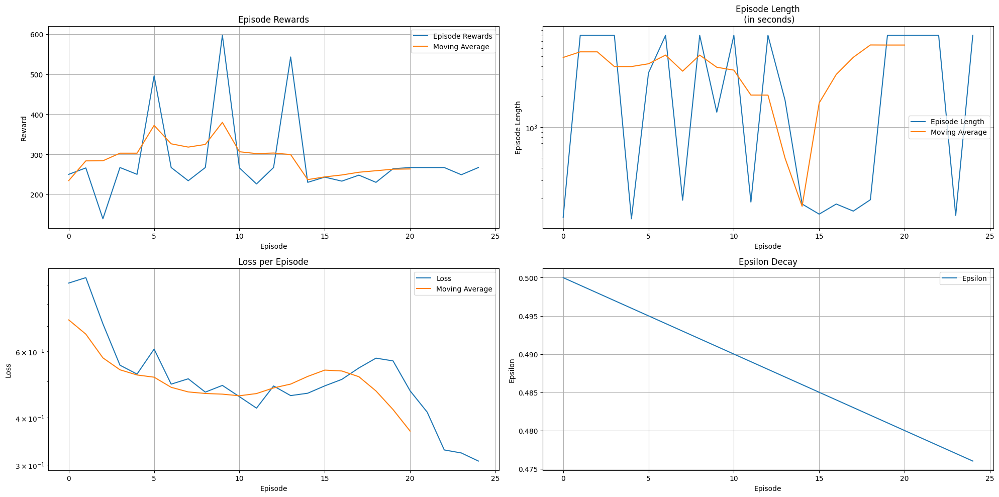

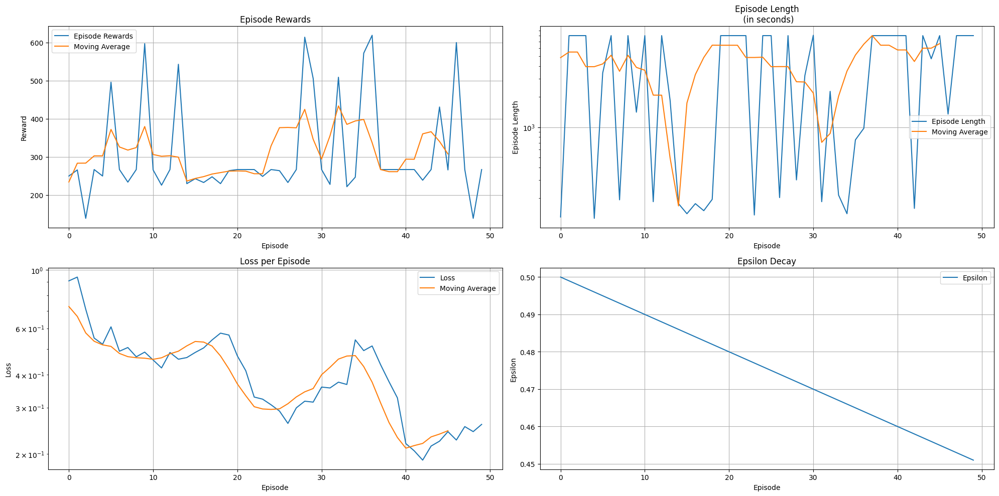

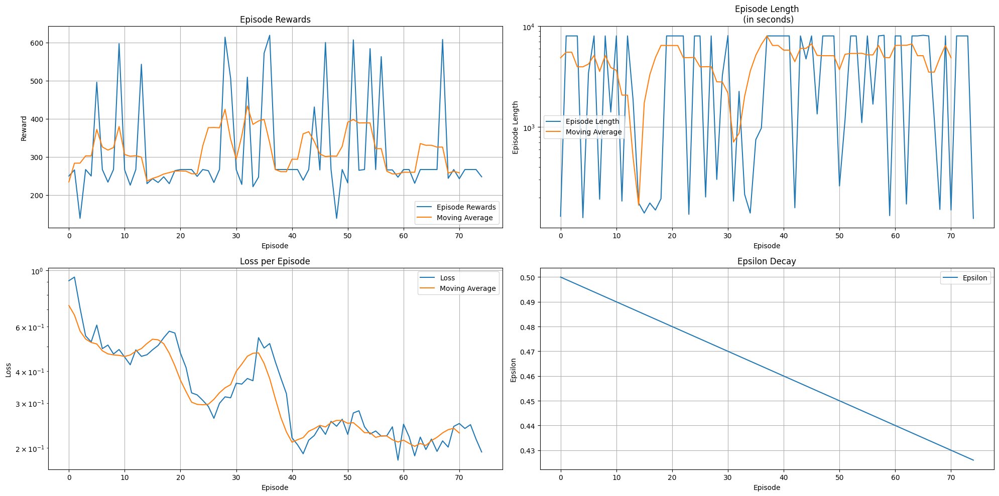

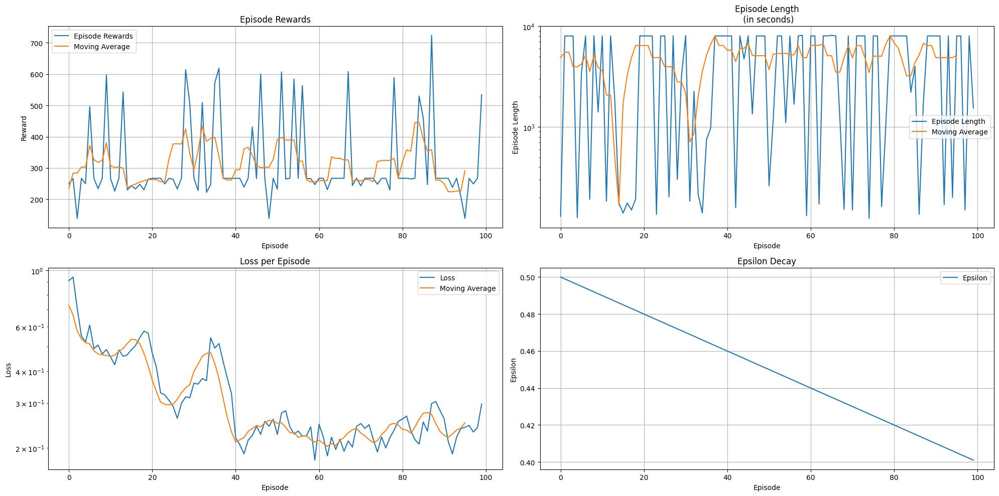

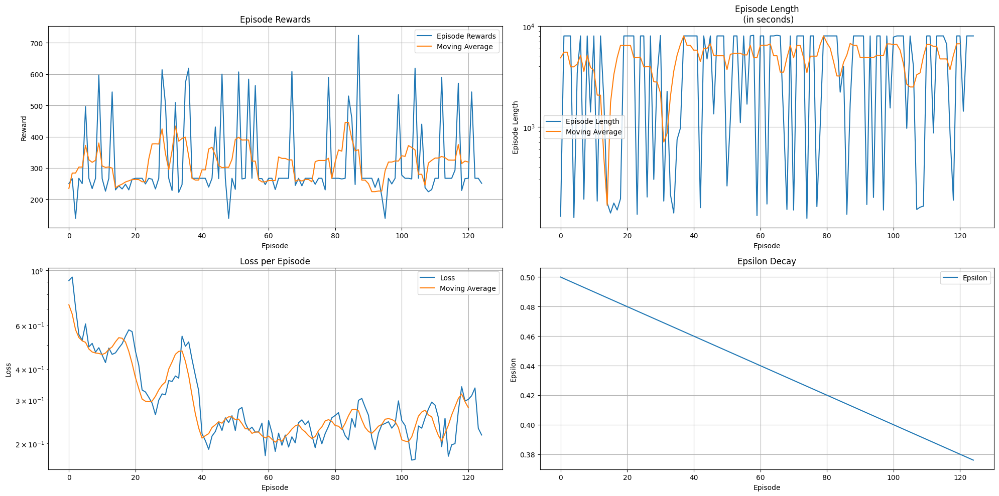

...

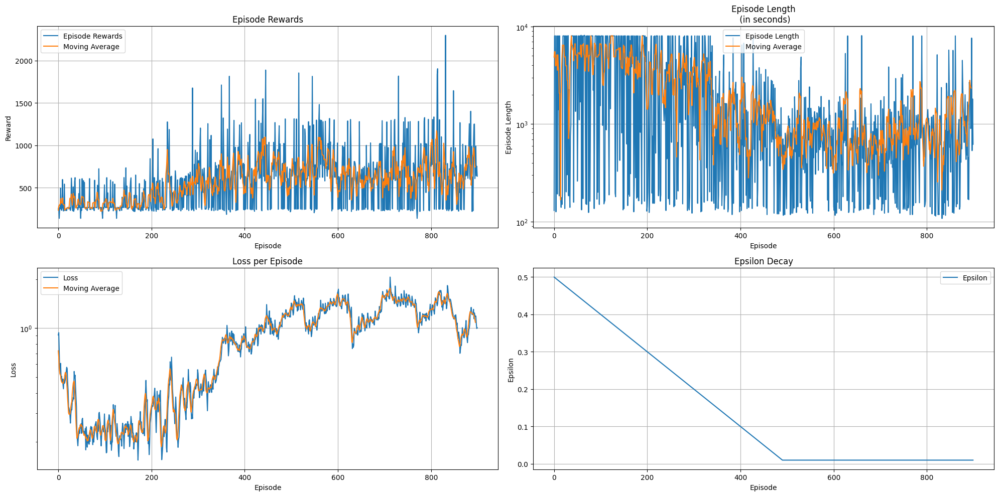

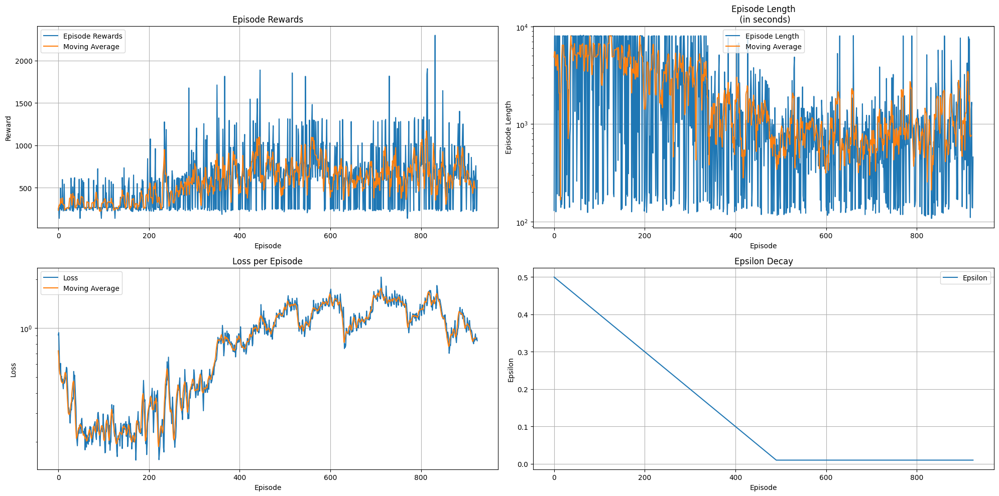

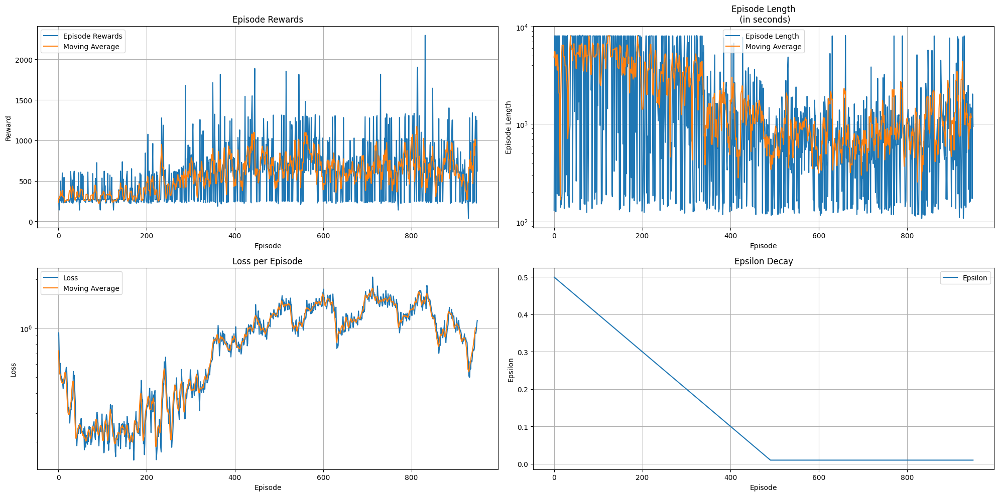

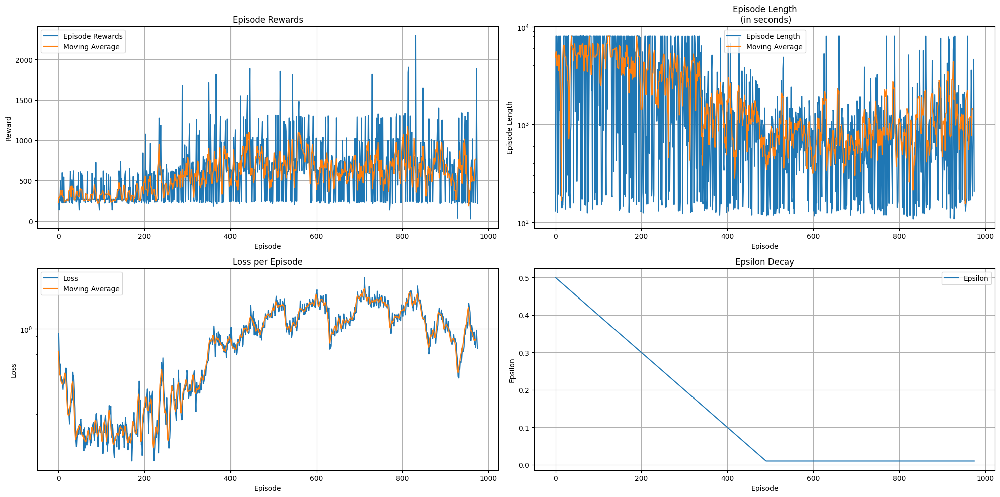

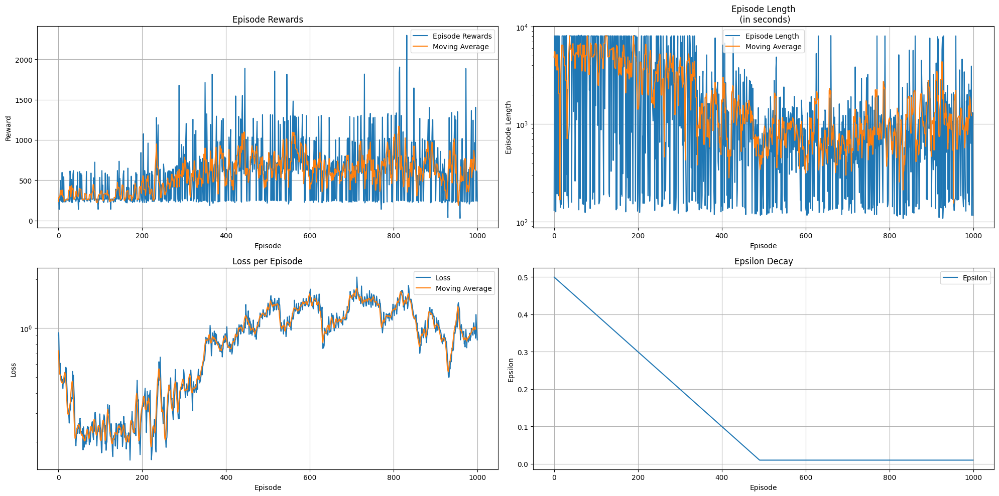

In [5]:
for episode in range(1, num_episodes + 1):
    state = env.reset()
    total_reward = 0
    steps = 0
    mean_episode_q = []
    mean_episode_loss = []
    # Initiate loop for the current episode to play the game until it ends
    while True:
        # To visualize the training, uncomment the following line
        # env.render()
        action = mario.selectAction(state)
        next_state, reward, resetnow, info = env.step(action)
        mario.saveExp(state, action, next_state, reward, resetnow)
        q, loss = mario.learn_get_TDest_loss()
        state = next_state
        total_reward = total_reward + reward
        steps = steps + 1
        mean_episode_q.append(q)
        mean_episode_loss.append(loss)
        if resetnow or info["flag_get"]:
            break
    print(
        f"Episode {episode} abgeschlossen mit {steps} Schritten, Gesamtbelohnung: {total_reward}, Epsilon: {mario.epsilon}\n\n"
    )
    # Save the results of the current episode
    reward_list.append(total_reward)
    steps_list.append(steps)
    q_list.append(np.mean(mean_episode_q))
    loss_list.append(np.mean(mean_episode_loss))
    epsilon_list.append(mario.epsilon)

    # Plot the results of all episodes at the defined intervals
    if episode % plot_every == 0:
        create_plots(
            reward_list,
            steps_list,
            loss_list,
            epsilon_list,
            save_path=os.path.join(plot_folder, f"plot_{episode}"),
        )


    # Save the model at the defined intervals
    if episode % save_every == 0:
        torch.save(
            dict(
                model=mario.model.state_dict(),
                optimizer=mario.optimizer.state_dict(),
                epsilon=mario.epsilon,
            ),
            os.path.join(checkpoint_folder, f"model_ep{episode}.pth"),
        )

    # Decay the epsilon value at the end of each episode
    mario.decayEpsilon(strat="lin")

# Save the final model after all episodes are completed
torch.save(
    dict(
        model=mario.model.state_dict(),
        optimizer=mario.optimizer.state_dict(),
        epsilon=mario.epsilon,
    ),
    os.path.join(model_folder, trainfolder, f"final_model_{train_version}.pth"),
)

# Close the environment
env.close()